<a href="https://colab.research.google.com/github/Fahim00727/Analysis-on-a-Brain-Stroke/blob/main/Brain_Stroke_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Importing libraries and Dataset**

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
df = pd.read_csv("Copy_of_brain_stroke.csv")
print("The dataset has %d rows and %d columns." % df.shape)

The dataset has 4981 rows and 11 columns.


In [ ]:
df.shape

(4981, 11)

In [ ]:
df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1
1,Male,80.0,0,1,Yes,Private,Rural,105.92,32.5,never smoked,1
2,Female,49.0,0,0,Yes,Private,Urban,171.23,34.4,smokes,1
3,Female,79.0,1,0,Yes,Self-employed,Rural,174.12,24.0,never smoked,1
4,Male,81.0,0,0,Yes,Private,Urban,186.21,29.0,formerly smoked,1


In [ ]:
df.tail()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
4976,Male,41.0,0,0,No,Private,Rural,70.15,29.8,formerly smoked,0
4977,Male,40.0,0,0,Yes,Private,Urban,191.15,31.1,smokes,0
4978,Female,45.0,1,0,Yes,Govt_job,Rural,95.02,31.8,smokes,0
4979,Male,40.0,0,0,Yes,Private,Rural,83.94,30.0,smokes,0
4980,Female,80.0,1,0,Yes,Private,Urban,83.75,29.1,never smoked,0


In [ ]:
df.dtypes

gender                object
age                  float64
hypertension           int64
heart_disease          int64
ever_married          object
work_type             object
Residence_type        object
avg_glucose_level    float64
bmi                  float64
smoking_status        object
stroke                 int64
dtype: object

In [ ]:
df.describe()

,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,43.419859,0.096165,0.055210,105.943562,28.498173,0.049789
std,22.662755,0.294848,0.228412,45.075373,6.790464,0.217531
min,0.080000,0.000000,0.000000,55.120000,14.000000,0.000000
25%,25.000000,0.000000,0.000000,77.230000,23.700000,0.000000
50%,45.000000,0.000000,0.000000,91.850000,28.100000,0.000000
75%,61.000000,0.000000,0.000000,113.860000,32.600000,0.000000
max,82.000000,1.000000,1.000000,271.740000,48.900000,1.000000


# **Checking Null Values**

## **Checking the null values for any feature**

In [ ]:
pd.isnull(df).any()

gender               False
age                  False
hypertension         False
heart_disease        False
ever_married         False
work_type            False
Residence_type       False
avg_glucose_level    False
bmi                  False
smoking_status       False
stroke               False
dtype: bool

In [ ]:
pd.isnull(df).sum()

gender               0
age                  0
hypertension         0
heart_disease        0
ever_married         0
work_type            0
Residence_type       0
avg_glucose_level    0
bmi                  0
smoking_status       0
stroke               0
dtype: int64

In [ ]:
missing_values = df[pd.isnull(df).any(axis=1)]
missing_values

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke


In [ ]:
noisy_values = df[df.isin([-1]).any(axis=1)]
noisy_values

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke


## **Checking all the unique values of each feature**



In [ ]:
uniq = df.apply(lambda u: u.unique()) #all the unique value in each column.
uniq

gender                                                  [Male, Female]
age                  [67.0, 80.0, 49.0, 79.0, 81.0, 74.0, 69.0, 78....
hypertension                                                    [0, 1]
heart_disease                                                   [1, 0]
ever_married                                                 [Yes, No]
work_type                 [Private, Self-employed, Govt_job, children]
Residence_type                                          [Urban, Rural]
avg_glucose_level    [228.69, 105.92, 171.23, 174.12, 186.21, 70.09...
bmi                  [36.6, 32.5, 34.4, 24.0, 29.0, 27.4, 22.8, 24....
smoking_status        [formerly smoked, never smoked, smokes, Unknown]
stroke                                                          [1, 0]
dtype: object

In [ ]:
nuniq = df.apply(lambda u: u.nunique()) #Number of Unique values in each Column.
nuniq

gender                  2
age                   104
hypertension            2
heart_disease           2
ever_married            2
work_type               4
Residence_type          2
avg_glucose_level    3895
bmi                   342
smoking_status          4
stroke                  2
dtype: int64

## **Checking unique values of each object type columns**

In [ ]:
df['gender'].unique()

array(['Male', 'Female'], dtype=object)

In [ ]:
df['ever_married'].unique()

array(['Yes', 'No'], dtype=object)

In [ ]:
df['work_type'].unique()

array(['Private', 'Self-employed', 'Govt_job', 'children'], dtype=object)

In [ ]:
df['Residence_type'].unique()

array(['Urban', 'Rural'], dtype=object)

In [ ]:
df['smoking_status'].unique()

array(['formerly smoked', 'never smoked', 'smokes', 'Unknown'],
      dtype=object)

We can see the smoking_status feature has a value 'Unknown' which needs to pre-processed.

# **Pre-processing**

## **Pre-processing dataset initially for all the features**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder

def preprocess_data(df):
    # pre_df = df
    pre_df = df.copy()

    pre_df['age'] = pre_df['age'].astype('int') #we converted the age column's datatype from float to integer

    pre_df["gender"] = pre_df["gender"].apply(lambda x: 1 if x=="Male" else 0)

    pre_df["ever_married"] = pre_df["ever_married"].apply(lambda x: 1 if x=="Yes" else 0)

    pre_df["work_type"] = pre_df["work_type"].apply(lambda x: 0 if x=="Govt_job" else (1 if x=="Private" else (2 if x=="Self-employed" else 3)))

    pre_df["Residence_type"] = pre_df["Residence_type"].apply(lambda x: 1 if x=="Urban" else 0)

    pre_df["smoking_status"] = pre_df["smoking_status"].apply(lambda x: 0 if x=="never smoked" else (1 if x=="smokes" else (2 if x=="formerly smoked" else '')))

    pre_df['smoking_status']=pd.to_numeric(pre_df['smoking_status'])  #we converted the smoking_status column's datatype from object to numeric

    return pre_df

In [ ]:
pre_df = preprocess_data(df)

In [ ]:
pre_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2.0,1
1,1,80,0,1,1,1,0,105.92,32.5,0.0,1
2,0,49,0,0,1,1,1,171.23,34.4,1.0,1
3,0,79,1,0,1,2,0,174.12,24.0,0.0,1
4,1,81,0,0,1,1,1,186.21,29.0,2.0,1


Here, we preprocessed the data and changed the smoking_status Unknown values into NULL values. then converted the whole column to float type from Object type.

## **Handling Null Values.**

### **Dropping the rows with Null values**

In [ ]:
Drop_df = pre_df.copy()

In [ ]:
Drop_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2.0,1
1,1,80,0,1,1,1,0,105.92,32.5,0.0,1
2,0,49,0,0,1,1,1,171.23,34.4,1.0,1
3,0,79,1,0,1,2,0,174.12,24.0,0.0,1
4,1,81,0,0,1,1,1,186.21,29.0,2.0,1


In [ ]:
pd.isnull(Drop_df).sum()

gender                  0
age                     0
hypertension            0
heart_disease           0
ever_married            0
work_type               0
Residence_type          0
avg_glucose_level       0
bmi                     0
smoking_status       1500
stroke                  0
dtype: int64

In [ ]:
Drop_df[pd.isnull(Drop_df).any(axis=1)]

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
7,0,78,0,0,1,1,1,58.57,24.2,NaN,1
19,1,82,0,1,1,1,0,208.30,32.5,NaN,1
25,1,42,0,0,1,1,0,83.41,25.4,NaN,1
32,1,58,0,0,0,1,0,92.62,32.0,NaN,1
54,1,76,0,0,1,1,1,104.47,20.3,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...
4958,1,32,1,0,0,1,0,74.43,31.5,NaN,0
4962,1,3,0,0,0,3,0,194.75,20.1,NaN,0
4967,1,59,0,0,1,1,1,223.16,33.2,NaN,0
4969,0,70,0,1,1,2,0,65.68,28.6,NaN,0


In [ ]:
missing = Drop_df.dropna(axis=0)

In [ ]:
missing.shape

(3481, 11)

In [ ]:
missing.isnull().any()

gender               False
age                  False
hypertension         False
heart_disease        False
ever_married         False
work_type            False
Residence_type       False
avg_glucose_level    False
bmi                  False
smoking_status       False
stroke               False
dtype: bool

### **Filling Null values with Constant Values**

In [ ]:
constant_df = pre_df.copy()

In [ ]:
constant_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2.0,1
1,1,80,0,1,1,1,0,105.92,32.5,0.0,1
2,0,49,0,0,1,1,1,171.23,34.4,1.0,1
3,0,79,1,0,1,2,0,174.12,24.0,0.0,1
4,1,81,0,0,1,1,1,186.21,29.0,2.0,1


In [ ]:
constant_df[pd.isnull(constant_df).any(axis=1)]

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
7,0,78,0,0,1,1,1,58.57,24.2,NaN,1
19,1,82,0,1,1,1,0,208.30,32.5,NaN,1
25,1,42,0,0,1,1,0,83.41,25.4,NaN,1
32,1,58,0,0,0,1,0,92.62,32.0,NaN,1
54,1,76,0,0,1,1,1,104.47,20.3,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...
4958,1,32,1,0,0,1,0,74.43,31.5,NaN,0
4962,1,3,0,0,0,3,0,194.75,20.1,NaN,0
4967,1,59,0,0,1,1,1,223.16,33.2,NaN,0
4969,0,70,0,1,1,2,0,65.68,28.6,NaN,0


In [ ]:
constant_df['smoking_status'] = constant_df['smoking_status'].fillna(0, inplace=False)

In [ ]:
constant_df.isnull().any()

gender               False
age                  False
hypertension         False
heart_disease        False
ever_married         False
work_type            False
Residence_type       False
avg_glucose_level    False
bmi                  False
smoking_status       False
stroke               False
dtype: bool

In [ ]:
constant_df.iloc[7]

gender                0.00
age                  78.00
hypertension          0.00
heart_disease         0.00
ever_married          1.00
work_type             1.00
Residence_type        1.00
avg_glucose_level    58.57
bmi                  24.20
smoking_status        0.00
stroke                1.00
Name: 7, dtype: float64

In [ ]:
constant_df.iloc[19]

gender                 1.0
age                   82.0
hypertension           0.0
heart_disease          1.0
ever_married           1.0
work_type              1.0
Residence_type         0.0
avg_glucose_level    208.3
bmi                   32.5
smoking_status         0.0
stroke                 1.0
Name: 19, dtype: float64

In [ ]:
constant_df.iloc[25]

gender                1.00
age                  42.00
hypertension          0.00
heart_disease         0.00
ever_married          1.00
work_type             1.00
Residence_type        0.00
avg_glucose_level    83.41
bmi                  25.40
smoking_status        0.00
stroke                1.00
Name: 25, dtype: float64

In [ ]:
constant_df.iloc[4973]

gender                 1.00
age                    1.00
hypertension           0.00
heart_disease          0.00
ever_married           0.00
work_type              3.00
Residence_type         0.00
avg_glucose_level    107.02
bmi                   18.80
smoking_status         0.00
stroke                 0.00
Name: 4973, dtype: float64

### **Filling Null values with Mean values**

In [ ]:
mean_df = pre_df.copy()

In [ ]:
mean_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2.0,1
1,1,80,0,1,1,1,0,105.92,32.5,0.0,1
2,0,49,0,0,1,1,1,171.23,34.4,1.0,1
3,0,79,1,0,1,2,0,174.12,24.0,0.0,1
4,1,81,0,0,1,1,1,186.21,29.0,2.0,1


In [ ]:
mean_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,3481.000000,4981.000000
mean,0.416382,43.408552,0.096165,0.055210,0.658502,1.302349,0.508332,105.943562,28.498173,0.721057,0.049789
std,0.493008,22.683945,0.294848,0.228412,0.474260,0.860170,0.499981,45.075373,6.790464,0.836342,0.217531
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.120000,14.000000,0.000000,0.000000
25%,0.000000,25.000000,0.000000,0.000000,0.000000,1.000000,0.000000,77.230000,23.700000,0.000000,0.000000
50%,0.000000,45.000000,0.000000,0.000000,1.000000,1.000000,1.000000,91.850000,28.100000,0.000000,0.000000
75%,1.000000,61.000000,0.000000,0.000000,1.000000,2.000000,1.000000,113.860000,32.600000,1.000000,0.000000
max,1.000000,82.000000,1.000000,1.000000,1.000000,3.000000,1.000000,271.740000,48.900000,2.000000,1.000000


In [ ]:
mean_df[pd.isnull(mean_df).any(axis=1)]

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
7,0,78,0,0,1,1,1,58.57,24.2,NaN,1
19,1,82,0,1,1,1,0,208.30,32.5,NaN,1
25,1,42,0,0,1,1,0,83.41,25.4,NaN,1
32,1,58,0,0,0,1,0,92.62,32.0,NaN,1
54,1,76,0,0,1,1,1,104.47,20.3,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...
4958,1,32,1,0,0,1,0,74.43,31.5,NaN,0
4962,1,3,0,0,0,3,0,194.75,20.1,NaN,0
4967,1,59,0,0,1,1,1,223.16,33.2,NaN,0
4969,0,70,0,1,1,2,0,65.68,28.6,NaN,0


In [ ]:
mean_df = mean_df.fillna(mean_df.mean())

In [ ]:
mean_df.isnull().any()

gender               False
age                  False
hypertension         False
heart_disease        False
ever_married         False
work_type            False
Residence_type       False
avg_glucose_level    False
bmi                  False
smoking_status       False
stroke               False
dtype: bool

In [ ]:
mean_df.iloc[7]

gender                0.000000
age                  78.000000
hypertension          0.000000
heart_disease         0.000000
ever_married          1.000000
work_type             1.000000
Residence_type        1.000000
avg_glucose_level    58.570000
bmi                  24.200000
smoking_status        0.721057
stroke                1.000000
Name: 7, dtype: float64

In [ ]:
mean_df.iloc[19]

gender                 1.000000
age                   82.000000
hypertension           0.000000
heart_disease          1.000000
ever_married           1.000000
work_type              1.000000
Residence_type         0.000000
avg_glucose_level    208.300000
bmi                   32.500000
smoking_status         0.721057
stroke                 1.000000
Name: 19, dtype: float64

In [ ]:
mean_df.iloc[25]

gender                1.000000
age                  42.000000
hypertension          0.000000
heart_disease         0.000000
ever_married          1.000000
work_type             1.000000
Residence_type        0.000000
avg_glucose_level    83.410000
bmi                  25.400000
smoking_status        0.721057
stroke                1.000000
Name: 25, dtype: float64

In [ ]:
mean_df.iloc[4973]

gender                 1.000000
age                    1.000000
hypertension           0.000000
heart_disease          0.000000
ever_married           0.000000
work_type              3.000000
Residence_type         0.000000
avg_glucose_level    107.020000
bmi                   18.800000
smoking_status         0.721057
stroke                 0.000000
Name: 4973, dtype: float64

### **Filling Null values with random draws from the distribution of the variable**

In [ ]:
random_dist_df = pre_df.copy()

In [ ]:
random_dist_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2.0,1
1,1,80,0,1,1,1,0,105.92,32.5,0.0,1
2,0,49,0,0,1,1,1,171.23,34.4,1.0,1
3,0,79,1,0,1,2,0,174.12,24.0,0.0,1
4,1,81,0,0,1,1,1,186.21,29.0,2.0,1


In [ ]:
random_dist_df[pd.isnull(random_dist_df).any(axis=1)]

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
7,0,78,0,0,1,1,1,58.57,24.2,NaN,1
19,1,82,0,1,1,1,0,208.30,32.5,NaN,1
25,1,42,0,0,1,1,0,83.41,25.4,NaN,1
32,1,58,0,0,0,1,0,92.62,32.0,NaN,1
54,1,76,0,0,1,1,1,104.47,20.3,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...
4958,1,32,1,0,0,1,0,74.43,31.5,NaN,0
4962,1,3,0,0,0,3,0,194.75,20.1,NaN,0
4967,1,59,0,0,1,1,1,223.16,33.2,NaN,0
4969,0,70,0,1,1,2,0,65.68,28.6,NaN,0


In [ ]:
import numpy as np
def fillNaN_with_unifrand(df):
    a = df.values
    # Checking how many isNaNs are there
    m = np.isnan(a) # mask of NaNs
    # Generating varables for passing to normal distribution
    mu, sigma = df.mean(), df.std()
    a[m] = np.random.normal(mu, sigma, size=m.sum())
    return df

In [ ]:
random_dist_df['smoking_status'] = fillNaN_with_unifrand(random_dist_df['smoking_status'])

In [ ]:
random_dist_df.isnull().any()

gender               False
age                  False
hypertension         False
heart_disease        False
ever_married         False
work_type            False
Residence_type       False
avg_glucose_level    False
bmi                  False
smoking_status       False
stroke               False
dtype: bool

In [ ]:
random_dist_df.iloc[7]

gender                0.000000
age                  78.000000
hypertension          0.000000
heart_disease         0.000000
ever_married          1.000000
work_type             1.000000
Residence_type        1.000000
avg_glucose_level    58.570000
bmi                  24.200000
smoking_status       -0.036112
stroke                1.000000
Name: 7, dtype: float64

In [ ]:
random_dist_df.iloc[19]

gender                 1.000000
age                   82.000000
hypertension           0.000000
heart_disease          1.000000
ever_married           1.000000
work_type              1.000000
Residence_type         0.000000
avg_glucose_level    208.300000
bmi                   32.500000
smoking_status         1.011048
stroke                 1.000000
Name: 19, dtype: float64

In [ ]:
random_dist_df.iloc[32]

gender                1.00000
age                  58.00000
hypertension          0.00000
heart_disease         0.00000
ever_married          0.00000
work_type             1.00000
Residence_type        0.00000
avg_glucose_level    92.62000
bmi                  32.00000
smoking_status        1.38519
stroke                1.00000
Name: 32, dtype: float64

In [ ]:
random_dist_df.iloc[4973]

gender                 1.000000
age                    1.000000
hypertension           0.000000
heart_disease          0.000000
ever_married           0.000000
work_type              3.000000
Residence_type         0.000000
avg_glucose_level    107.020000
bmi                   18.800000
smoking_status        -0.838145
stroke                 0.000000
Name: 4973, dtype: float64

### **Filling Null values of smoking_status with random integers**

**Randomizing values of smoking_status between 0 and 2**

In [ ]:
random_df = pre_df.copy()

In [ ]:
import numpy as np
import random
def fillNaN_with_unifrand(df):
  a = df.values
  m = np.isnan(a)

  for i,j in enumerate(a):
    if(m[i]):
      a[i] = np.random.randint(0,3)
  return df

In [ ]:
random_df['smoking_status'] = fillNaN_with_unifrand(random_df['smoking_status'])

In [ ]:
random_df['smoking_status'] = random_df['smoking_status'].astype('int')

In [ ]:
random_df['smoking_status'].unique()

array([2, 0, 1])

In [ ]:
random_df.iloc[7]

gender                0.00
age                  78.00
hypertension          0.00
heart_disease         0.00
ever_married          1.00
work_type             1.00
Residence_type        1.00
avg_glucose_level    58.57
bmi                  24.20
smoking_status        2.00
stroke                1.00
Name: 7, dtype: float64

In [ ]:
random_df.iloc[19]

gender                 1.0
age                   82.0
hypertension           0.0
heart_disease          1.0
ever_married           1.0
work_type              1.0
Residence_type         0.0
avg_glucose_level    208.3
bmi                   32.5
smoking_status         2.0
stroke                 1.0
Name: 19, dtype: float64

In [ ]:
random_df.iloc[25]

gender                1.00
age                  42.00
hypertension          0.00
heart_disease         0.00
ever_married          1.00
work_type             1.00
Residence_type        0.00
avg_glucose_level    83.41
bmi                  25.40
smoking_status        1.00
stroke                1.00
Name: 25, dtype: float64

In [ ]:
random_df.iloc[4973]

gender                 1.00
age                    1.00
hypertension           0.00
heart_disease          0.00
ever_married           0.00
work_type              3.00
Residence_type         0.00
avg_glucose_level    107.02
bmi                   18.80
smoking_status         0.00
stroke                 0.00
Name: 4973, dtype: float64

In [ ]:
random_df.dtypes

gender                 int64
age                    int64
hypertension           int64
heart_disease          int64
ever_married           int64
work_type              int64
Residence_type         int64
avg_glucose_level    float64
bmi                  float64
smoking_status         int64
stroke                 int64
dtype: object

In [ ]:
random_df.head(30)

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67,0,1,1,1,1,228.69,36.6,2,1
1,1,80,0,1,1,1,0,105.92,32.5,0,1
2,0,49,0,0,1,1,1,171.23,34.4,1,1
3,0,79,1,0,1,2,0,174.12,24.0,0,1
4,1,81,0,0,1,1,1,186.21,29.0,2,1
5,1,74,1,1,1,1,0,70.09,27.4,0,1
6,0,69,0,0,0,1,1,94.39,22.8,0,1
7,0,78,0,0,1,1,1,58.57,24.2,2,1
8,0,81,1,0,1,1,0,80.43,29.7,0,1
9,0,61,0,1,1,0,0,120.46,36.8,1,1


In [ ]:
random_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,43.408552,0.096165,0.055210,0.658502,1.302349,0.508332,105.943562,28.498173,0.805059,0.049789
std,0.493008,22.683945,0.294848,0.228412,0.474260,0.860170,0.499981,45.075373,6.790464,0.842128,0.217531
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.120000,14.000000,0.000000,0.000000
25%,0.000000,25.000000,0.000000,0.000000,0.000000,1.000000,0.000000,77.230000,23.700000,0.000000,0.000000
50%,0.000000,45.000000,0.000000,0.000000,1.000000,1.000000,1.000000,91.850000,28.100000,1.000000,0.000000
75%,1.000000,61.000000,0.000000,0.000000,1.000000,2.000000,1.000000,113.860000,32.600000,2.000000,0.000000
max,1.000000,82.000000,1.000000,1.000000,1.000000,3.000000,1.000000,271.740000,48.900000,2.000000,1.000000


In [ ]:
random_df.dtypes

gender                 int64
age                    int64
hypertension           int64
heart_disease          int64
ever_married           int64
work_type              int64
Residence_type         int64
avg_glucose_level    float64
bmi                  float64
smoking_status         int64
stroke                 int64
dtype: object

## **Importing the Pre-processed Dataset**

In [ ]:
import pandas as pd
pre_df = pd.read_csv("Copy_of_New_Brain_Stroke_Dataset.csv")

In [ ]:
pre_df.dtypes

gender                 int64
age                  float64
hypertension           int64
heart_disease          int64
ever_married           int64
work_type              int64
Residence_type         int64
avg_glucose_level    float64
bmi                  float64
smoking_status         int64
stroke                 int64
dtype: object

In [ ]:
pre_df.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67.0,0,1,1,0,1,228.69,36.6,3,1
1,1,80.0,0,1,1,0,0,105.92,32.5,1,1
2,0,49.0,0,0,1,0,1,171.23,34.4,2,1
3,0,79.0,1,0,1,2,0,174.12,24.0,1,1
4,1,81.0,0,0,1,0,1,186.21,29.0,3,1


In [ ]:
pre_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,43.419859,0.096165,0.055210,0.658502,0.857458,0.508332,105.943562,28.498173,1.806665,0.049789
std,0.493008,22.662755,0.294848,0.228412,0.474260,1.120706,0.499981,45.075373,6.790464,0.842498,0.217531
min,0.000000,0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,55.120000,14.000000,1.000000,0.000000
25%,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,77.230000,23.700000,1.000000,0.000000
50%,0.000000,45.000000,0.000000,0.000000,1.000000,0.000000,1.000000,91.850000,28.100000,2.000000,0.000000
75%,1.000000,61.000000,0.000000,0.000000,1.000000,2.000000,1.000000,113.860000,32.600000,3.000000,0.000000
max,1.000000,82.000000,1.000000,1.000000,1.000000,3.000000,1.000000,271.740000,48.900000,3.000000,1.000000


## **Finding outliers**

### **Calling Library files and setting the category**

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import PercentFormatter

In [ ]:
df_cat=pre_df[['gender','age','hypertension','heart_disease','ever_married','work_type','Residence_type','avg_glucose_level','bmi','smoking_status']].copy()

### **Histogram's of features with distinct values**

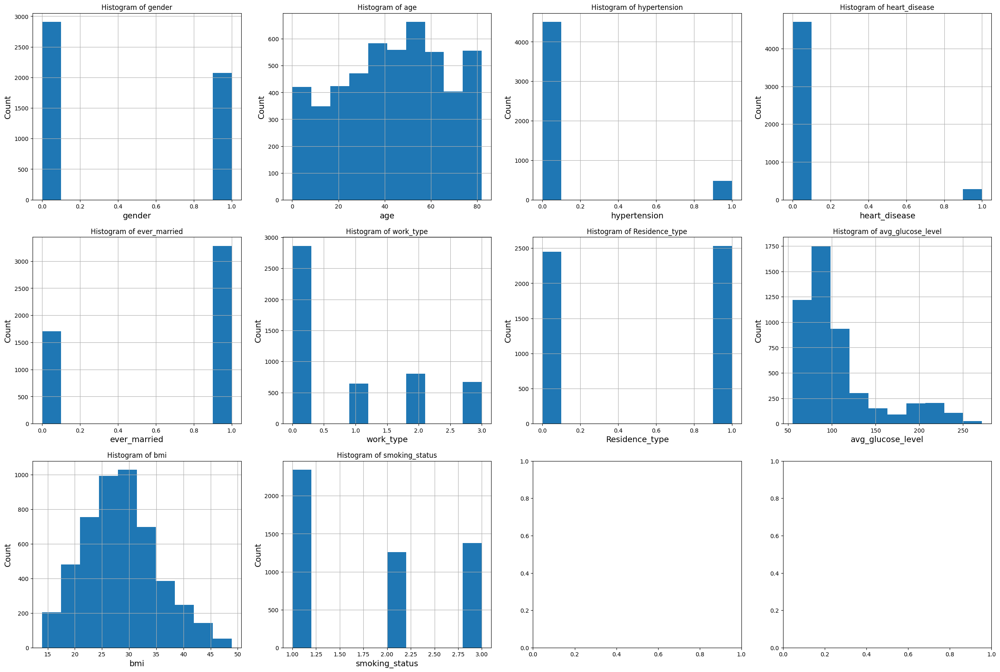

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import PercentFormatter

# figure
# plt.subplot(1,2,1)
# plt.hist(df['gender'])

# plt.subplot(1,2,2)
# plt.hist(df['hypertension'])
# figure
fig, axes = plt.subplots(3,4,figsize=(30,20))
axes=[ax for axes_row in axes for ax in axes_row]

# the histogram of the data
for i, c in enumerate(df_cat):
  axes[i].hist(pre_df[c])
  axes[i].set_ylabel('Count',fontsize=14)
  axes[i].set_xlabel(c,fontsize=14)
  axes[i].set_title('Histogram of '+c)
  axes[i].grid(True)
plt.show()

### **Scatterplot's of features with distinct values**

In [ ]:
scat_df = pre_df[['age','avg_glucose_level','bmi','age']].copy()
df_cat = np.asarray(scat_df)

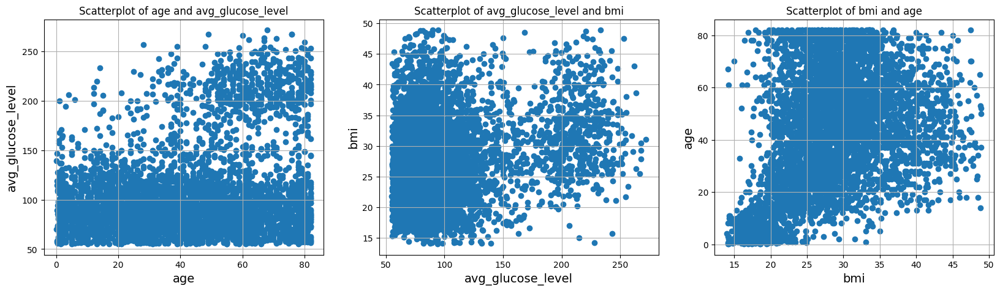

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import PercentFormatter

fig, axis = plt.subplots(1, len(df_cat[0])-1, figsize=(20,5))

for i in range(len(df_cat[0])-1):
  axis[i].scatter(df_cat[:,i],df_cat[:,i+1])
  axis[i].set_ylabel(scat_df.columns[i+1],fontsize=14)
  axis[i].set_xlabel(scat_df.columns[i],fontsize=14)
  axis[i].set_title('Scatterplot of '+scat_df.columns[i]+' and '+scat_df.columns[i+1])
  axis[i].grid(True)
plt.savefig("Scatter plotting on numeric variables.jpg")
plt.show()

### **Pie-Chart of features with distinct values**

In [ ]:
df_cat = pre_df[['gender','hypertension','heart_disease','ever_married','work_type','Residence_type','smoking_status']].copy()

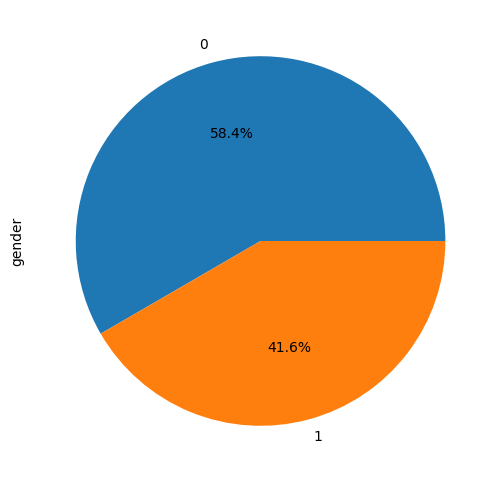

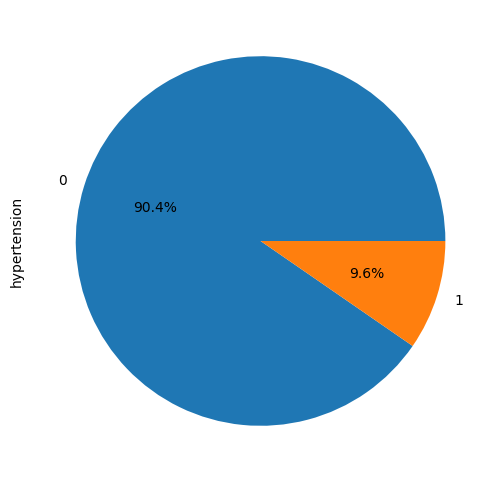

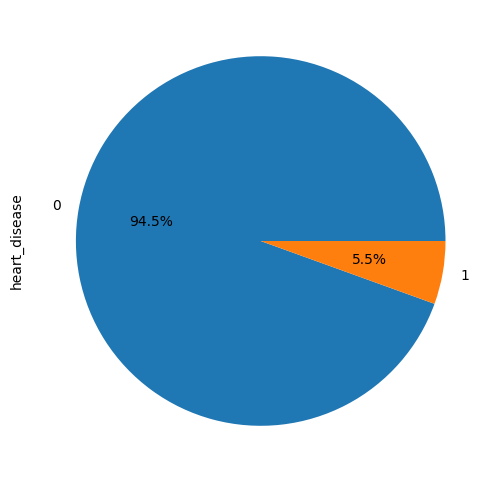

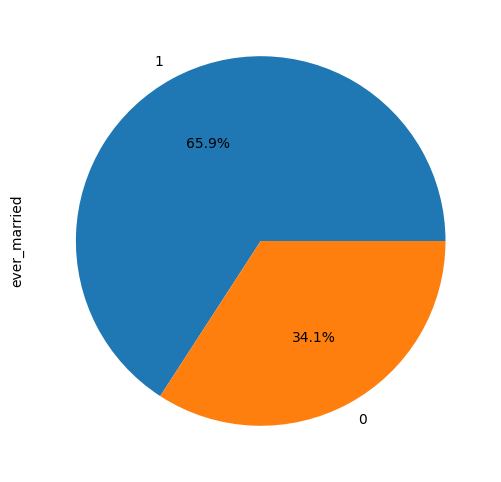

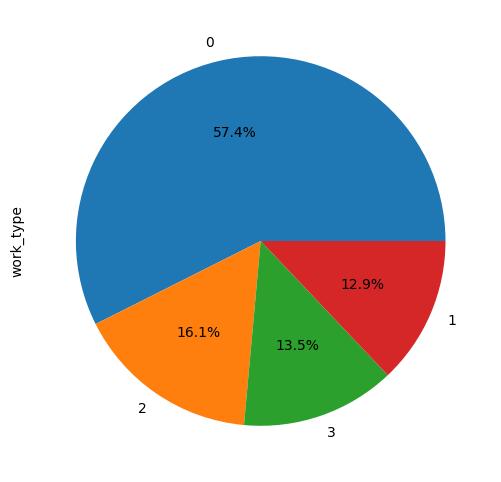

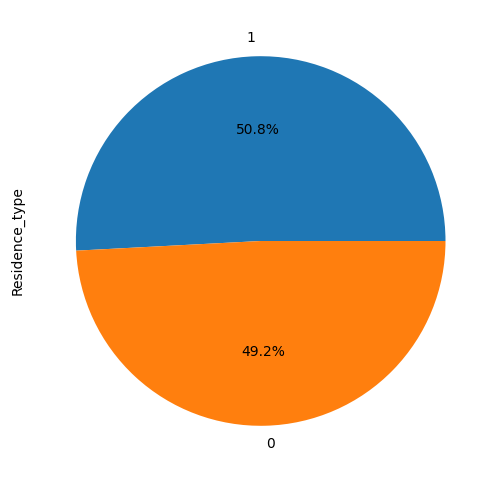

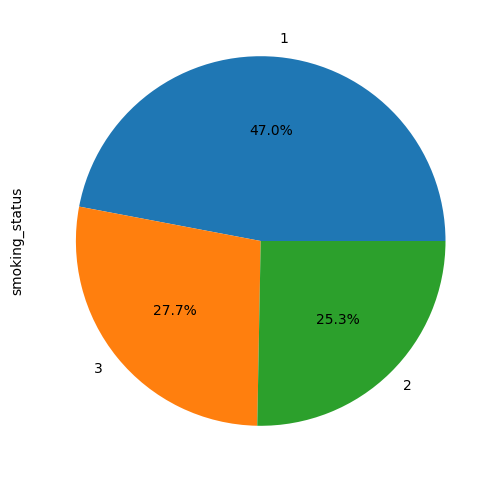

In [ ]:
for i in df_cat.columns:
    plt.figure(figsize = (15,6))
    df_cat[i].value_counts().plot(kind = 'pie', autopct = '%1.1f%%')
    plt.xticks(rotation = 100)
    plt.show()

### **Box-plot of features with continuous values**

In [ ]:
box_df = pre_df[['age','avg_glucose_level','bmi']].copy()

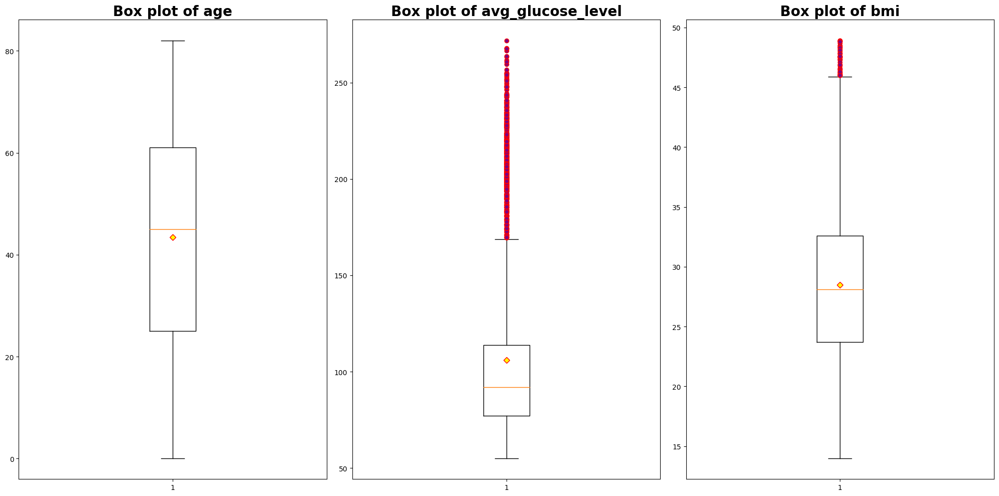

In [ ]:
red_circle = dict(markerfacecolor = 'purple', marker = 'o', markeredgecolor = 'red')
mean_shape = dict(markerfacecolor = 'yellow', marker = 'D', markeredgecolor = 'red')

fig, axis = plt.subplots(1, len(box_df.columns), figsize=(20,10))

for i, ax in enumerate(axis.flat):
  ax.boxplot(x = box_df.iloc[:,i], flierprops=red_circle, showmeans = True, meanprops = mean_shape )
  ax.set_title('Box plot of ' + box_df.columns[i], fontsize=20, fontweight='bold')
  ax.tick_params(axis='y', labelsize=10)

plt.tight_layout()

# **Data Transformation**

### **Min-Max Normalization**

In [ ]:
normalized_df = pre_df.copy()

In [ ]:
norm_cat_df = []
for i in normalized_df:
  if(normalized_df[i].dtype==float):
    norm_cat_df.append(normalized_df[i])
norm_cat_df = pd.DataFrame(norm_cat_df)
norm_cat_df = norm_cat_df.transpose()

In [ ]:
def Norm_Scale(df):
  df=(df-df.min())/(df.max()-df.min())
  return df

In [ ]:
for i in norm_cat_df:
    norm_cat_df[i] = Norm_Scale(norm_cat_df[i])

In [ ]:
for i in norm_cat_df:
    normalized_df[i] = norm_cat_df[i].copy()

In [ ]:
normalized_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,0.529051,0.096165,0.055210,0.658502,0.857458,0.508332,0.234621,0.415420,1.806665,0.049789
std,0.493008,0.276645,0.294848,0.228412,0.474260,1.120706,0.499981,0.208085,0.194569,0.842498,0.217531
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,0.000000,0.304199,0.000000,0.000000,0.000000,0.000000,0.000000,0.102068,0.277937,1.000000,0.000000
50%,0.000000,0.548340,0.000000,0.000000,1.000000,0.000000,1.000000,0.169560,0.404011,2.000000,0.000000
75%,1.000000,0.743652,0.000000,0.000000,1.000000,2.000000,1.000000,0.271166,0.532951,3.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,3.000000,1.000000,1.000000,1.000000,3.000000,1.000000


Min Max Normalization with customized min and max values

In [ ]:
normalized_new_mn_mx_df = pre_df.copy()

In [ ]:
norm_mn_mx_cat_df = []
for i in normalized_new_mn_mx_df:
  if(normalized_new_mn_mx_df[i].dtype==float):
    norm_mn_mx_cat_df.append(normalized_new_mn_mx_df[i])
norm_mn_mx_cat_df = pd.DataFrame(norm_mn_mx_cat_df)
norm_mn_mx_cat_df = norm_mn_mx_cat_df.transpose()

In [ ]:
def Norm_Scale(df):
  n_min = 5
  n_max = 10
  df=(((df-df.min())/(df.max()-df.min()))*(n_max-n_min))+n_min
  return df

In [ ]:
for i in norm_mn_mx_cat_df:
    norm_mn_mx_cat_df[i] = Norm_Scale(norm_mn_mx_cat_df[i])

In [ ]:
for i in norm_mn_mx_cat_df:
    normalized_new_mn_mx_df[i] = norm_mn_mx_cat_df[i].copy()

In [ ]:
normalized_new_mn_mx_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,7.645255,0.096165,0.055210,0.658502,0.857458,0.508332,6.173104,7.077102,1.806665,0.049789
std,0.493008,1.383225,0.294848,0.228412,0.474260,1.120706,0.499981,1.040425,0.972846,0.842498,0.217531
min,0.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,5.000000,1.000000,0.000000
25%,0.000000,6.520996,0.000000,0.000000,0.000000,0.000000,0.000000,5.510341,6.389685,1.000000,0.000000
50%,0.000000,7.741699,0.000000,0.000000,1.000000,0.000000,1.000000,5.847798,7.020057,2.000000,0.000000
75%,1.000000,8.718262,0.000000,0.000000,1.000000,2.000000,1.000000,6.355830,7.664756,3.000000,0.000000
max,1.000000,10.000000,1.000000,1.000000,1.000000,3.000000,1.000000,10.000000,10.000000,3.000000,1.000000


### **Z-Score Standardization**

In [ ]:
standardized_df = pre_df.copy()

In [ ]:
std_cat_df = []
for i in standardized_df:
  if(standardized_df[i].dtype==float):
    std_cat_df.append(standardized_df[i])
std_cat_df = pd.DataFrame(std_cat_df)
std_cat_df = std_cat_df.transpose()

In [ ]:
def Std_Scale(df):
  df=(df-df.mean())/df.std()
  return df

In [ ]:
for i in std_cat_df:
    std_cat_df[i] = Std_Scale(std_cat_df[i])

In [ ]:
for i in std_cat_df:
    standardized_df[i] = std_cat_df[i].copy()

In [ ]:
standardized_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4.981000e+03,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4.981000e+03,4.981000e+03,4981.000000,4981.000000
mean,0.416382,1.141205e-17,0.096165,0.055210,0.658502,0.857458,0.508332,1.198265e-16,-6.219567e-16,1.806665,0.049789
std,0.493008,1.000000e+00,0.294848,0.228412,0.474260,1.120706,0.499981,1.000000e+00,1.000000e+00,0.842498,0.217531
min,0.000000,-1.912383e+00,0.000000,0.000000,0.000000,0.000000,0.000000,-1.127524e+00,-2.135079e+00,1.000000,0.000000
25%,0.000000,-8.127811e-01,0.000000,0.000000,0.000000,0.000000,0.000000,-6.370122e-01,-7.066046e-01,1.000000,0.000000
50%,0.000000,6.972411e-02,0.000000,0.000000,1.000000,0.000000,1.000000,-3.126666e-01,-5.863709e-02,2.000000,0.000000
75%,1.000000,7.757283e-01,0.000000,0.000000,1.000000,2.000000,1.000000,1.756267e-01,6.040570e-01,3.000000,0.000000
max,1.000000,1.702359e+00,1.000000,1.000000,1.000000,3.000000,1.000000,3.678204e+00,3.004482e+00,3.000000,1.000000


### **Decimal Scalling**

In [ ]:
decimal_df=pre_df.copy()

In [ ]:
dec_cat_df = []
for i in decimal_df:
  if(decimal_df[i].dtype==float):
    dec_cat_df.append(decimal_df[i])
dec_cat_df = pd.DataFrame(dec_cat_df)
dec_cat_df = dec_cat_df.transpose()

In [ ]:
def Dec_Scale(df):
  p = int(df.max())
  q = len(str(abs(p)))
  df = df/(10**q)
  return df

In [ ]:
for i in dec_cat_df:
    dec_cat_df[i] = Dec_Scale(dec_cat_df[i])

In [ ]:
for i in dec_cat_df:
    decimal_df[i] = dec_cat_df[i].copy()

In [ ]:
decimal_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,0.434199,0.096165,0.055210,0.658502,0.857458,0.508332,0.105944,0.284982,1.806665,0.049789
std,0.493008,0.226628,0.294848,0.228412,0.474260,1.120706,0.499981,0.045075,0.067905,0.842498,0.217531
min,0.000000,0.000800,0.000000,0.000000,0.000000,0.000000,0.000000,0.055120,0.140000,1.000000,0.000000
25%,0.000000,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.077230,0.237000,1.000000,0.000000
50%,0.000000,0.450000,0.000000,0.000000,1.000000,0.000000,1.000000,0.091850,0.281000,2.000000,0.000000
75%,1.000000,0.610000,0.000000,0.000000,1.000000,2.000000,1.000000,0.113860,0.326000,3.000000,0.000000
max,1.000000,0.820000,1.000000,1.000000,1.000000,3.000000,1.000000,0.271740,0.489000,3.000000,1.000000


# **Exploratory Data Analysis**

## **Importing the pre-processed dataset**

In [ ]:
import pandas as pd
pre_df = pd.read_csv("Copy_of_New_Brain_Stroke_Dataset.csv")

## **Heatmap of all features to determine co-related variables**

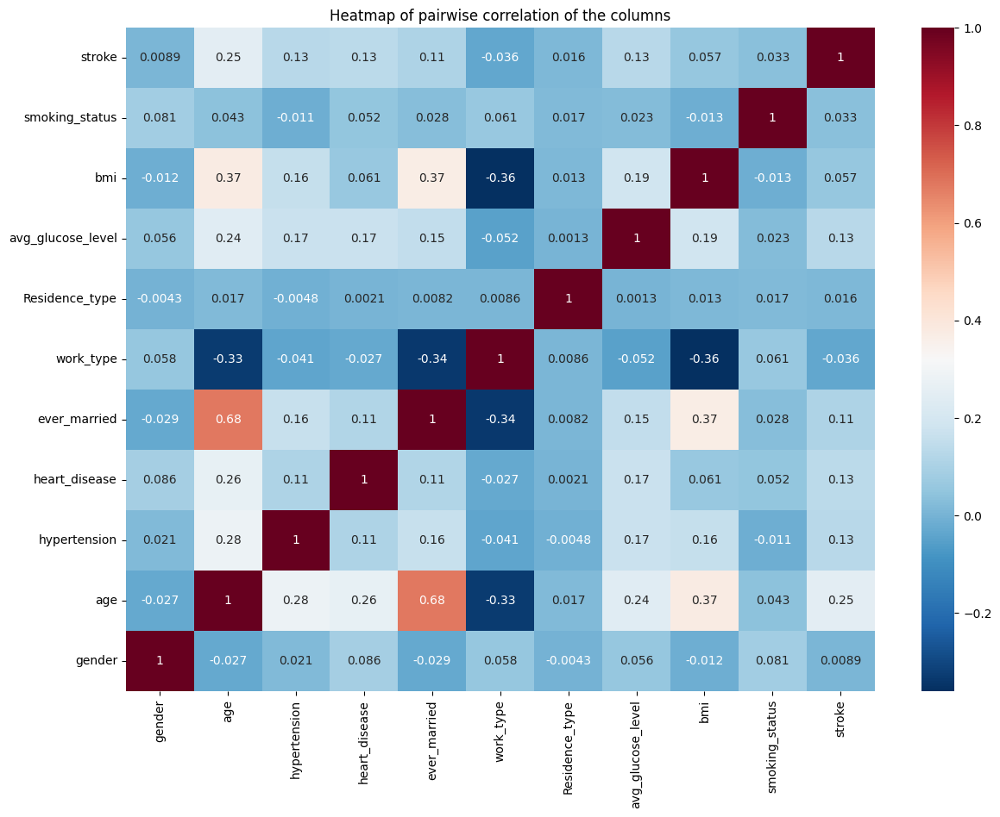

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(14, 10))

corr = pre_df.corr()

ax = sns.heatmap(corr, cmap = "RdBu_r", annot=True)

ax.invert_yaxis()

plt.title("Heatmap of pairwise correlation of the columns")

plt.show()

## **Exploring categorical variables**

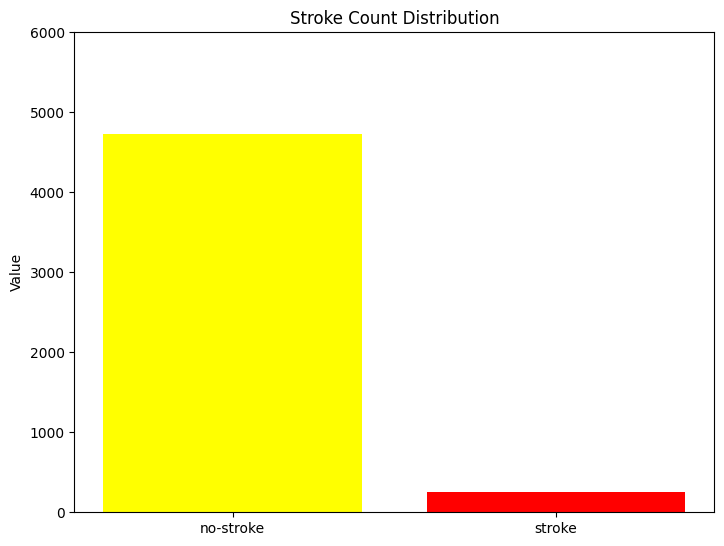

In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
target = ['no-stroke', 'stroke']
hists = [len(pre_df[pre_df["stroke"] == 0]),len(pre_df[pre_df["stroke"] == 1])]
ax.bar(target,hists, color=['yellow','red'],)
plt.title("Stroke Count Distribution")
plt.ylabel('Value')
plt.ylim(0,6000)
plt.show()

In [ ]:
stroke_perc = pre_df['stroke'].sum() * 100 / pre_df['stroke'].shape[0]
print("Stroke percentage is %.3f%%." % stroke_perc)

Stroke percentage is 4.979%.


### **Plotly Graphs**

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import plotly.express as px
px.pie(names = pre_df['stroke'],width = 400, height = 400, title="Values of Stroke - No-stroke")

#### **Histogram of each feature with discrete values**

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)

from plotly.offline import plot, iplot

import warnings
warnings.filterwarnings('ignore')

SEED = 17
pd.set_option('display.max_columns', None)

colors = plotly.colors.DEFAULT_PLOTLY_COLORS
stroke_dict = {0: "0", 1: "1"}

stroke = pre_df[pre_df["stroke"] == 1]
no_stroke = pre_df[pre_df["stroke"] == 0]

def create_stroke_trace(col, visible=False):
    return go.Histogram(
        x=stroke[col],
        name='Stroke',
        marker = dict(color = colors[1]),
        visible=visible,
    )

def create_no_stroke_trace(col, visible=False):
    return go.Histogram(
        x=no_stroke[col],
        name='No Stroke',
        marker = dict(color = colors[0]),
        visible = visible,
    )

features_not_for_hist = ['age', 'avg_glucose_level', 'bmi', 'stroke']
features_for_hist = [x for x in pre_df.columns if x not in features_not_for_hist]
active_idx = 0
traces_stroke = [(create_stroke_trace(col) if i != active_idx else create_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
traces_no_stroke = [(create_no_stroke_trace(col) if i != active_idx else create_no_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
data = traces_stroke + traces_no_stroke

n_features = len(features_for_hist)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_hist[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    step['args'][1][i + n_features] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='Value',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='histogram_slider')

#### **Barchart of Age**

In [ ]:
#plot libaries
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

SEED = 17 # specify seed for reproducable results
pd.set_option('display.max_columns', None) # prevents abbreviation (with '...') of columns in prints

colors = plotly.colors.DEFAULT_PLOTLY_COLORS
stroke_dict = {0: "0", 1: "1"}



state_stroke_df = pre_df.groupby(["age", "stroke"]).size().unstack()
trace1 = go.Bar(
    x=state_stroke_df.index,
    y=state_stroke_df[0],
    marker = dict(color = colors[0]),
    name='No Stroke'
)
trace2 = go.Bar(
    x=state_stroke_df.index,
    y=state_stroke_df[1],
    marker = dict(color = colors[1]),
    name='Stroke'
)
data = [trace1, trace2]
layout = go.Layout(
    title='Stroke Distribution per Age',
    autosize=True,
    barmode='stack',
    margin=go.layout.Margin(l=100, r=50),
    xaxis=dict(
        title='Age',
        tickangle=45
    ),
    yaxis=dict(
        title='Value',
        automargin=True,
    ),
    legend=dict(
        x=0,
        y=1,
    ),
)
fig = go.Figure(data=data, layout=layout)
fig.update_traces(width=0.5)  #had to update the width
iplot(fig, filename='stacked-bar')


## **Distribution Box Plots**

### **Box Plot's of each feature with continuous values using Plotly**

In [ ]:
configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

def create_box_stroke_trace(col, visible=False):
    return go.Box(
        y=stroke[col],
        name='stroke',
        marker = dict(color = colors[1]),
        visible=visible,
    )

def create_box_no_stroke_trace(col, visible=False):
    return go.Box(
        y=no_stroke[col],
        name='no stroke',
        marker = dict(color = colors[0]),
        visible = visible,
    )

features_not_for_hist = ['stroke']
features_for_hist = ['age', 'avg_glucose_level', 'bmi']

features_for_box = [col for col in features_for_hist if len(stroke[col].unique())>0]

active_idx = 0
box_traces_stroke = [(create_box_stroke_trace(col) if i != active_idx else create_box_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_box)]
box_traces_no_stroke = [(create_box_no_stroke_trace(col) if i != active_idx else create_box_no_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_box)]
data = box_traces_stroke + box_traces_no_stroke

n_features = len(features_for_box)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_box[i],
    )
    step['args'][1][i] = True
    step['args'][1][i + n_features] = True
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 75},
    steps = steps,
    len=1,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='Value',
        automargin=True,
    ),
    legend=dict(
        x=0,
        y=1,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='box_slider')

## **Exploring Numerical Variables**

In [ ]:
pre_df.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000,4981.000000
mean,0.416382,43.419859,0.096165,0.055210,0.658502,0.857458,0.508332,105.943562,28.498173,1.806665,0.049789
std,0.493008,22.662755,0.294848,0.228412,0.474260,1.120706,0.499981,45.075373,6.790464,0.842498,0.217531
min,0.000000,0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,55.120000,14.000000,1.000000,0.000000
25%,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,77.230000,23.700000,1.000000,0.000000
50%,0.000000,45.000000,0.000000,0.000000,1.000000,0.000000,1.000000,91.850000,28.100000,2.000000,0.000000
75%,1.000000,61.000000,0.000000,0.000000,1.000000,2.000000,1.000000,113.860000,32.600000,3.000000,0.000000
max,1.000000,82.000000,1.000000,1.000000,1.000000,3.000000,1.000000,271.740000,48.900000,3.000000,1.000000


#### **Histogram of each feature with continuous values**

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)

from plotly.offline import plot, iplot

import warnings
warnings.filterwarnings('ignore')

SEED = 17
pd.set_option('display.max_columns', None)

colors = plotly.colors.DEFAULT_PLOTLY_COLORS
stroke_dict = {0: "stroke", 1: "stroke"}

stroke = pre_df[pre_df["stroke"] == 1]
no_stroke = pre_df[pre_df["stroke"] == 0]

def create_stroke_trace(col, visible=False):
    return go.Histogram(
        x=stroke[col],
        name='stroke',
        marker = dict(color = colors[1]),
        visible=visible,
    )

def create_no_stroke_trace(col, visible=False):
    return go.Histogram(
        x=no_stroke[col],
        name='no stroke',
        marker = dict(color = colors[0]),
        visible = visible,
    )

features_not_for_hist = ['stroke']
features_for_hist = ['age', 'avg_glucose_level', 'bmi']
active_idx = 0
traces_stroke = [(create_stroke_trace(col) if i != active_idx else create_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
traces_no_stroke = [(create_no_stroke_trace(col) if i != active_idx else create_no_stroke_trace(col, visible=True)) for i, col in enumerate(features_for_hist)]
data = traces_stroke + traces_no_stroke

n_features = len(features_for_hist)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_hist[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    step['args'][1][i + n_features] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 75},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='Value',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='histogram_slider')

## **EXPLORING MULTIVARIATE RELATIONSHIPS - Scatter-plots**

### **2-D Scatterplots**

**Selecting Interesting subsets of the data for further investigation**

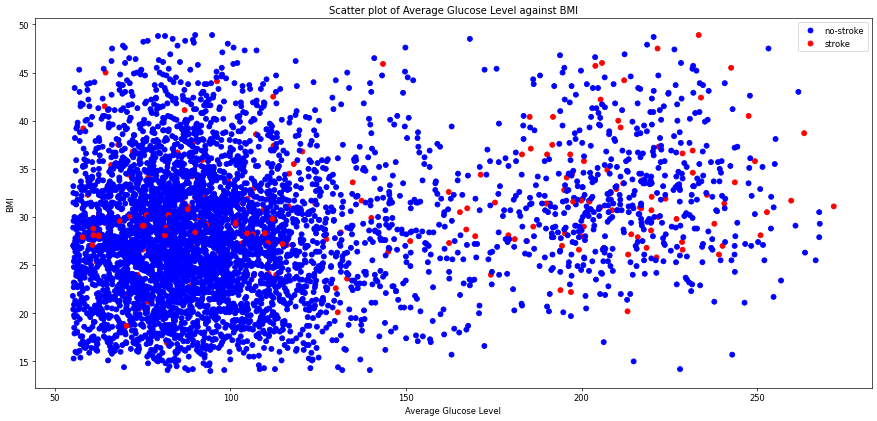

In [ ]:
import matplotlib
figure(figsize=(18, 8), dpi=60)

label = [0,1]
colors = ['blue','red']

scatter = plt.scatter(pre_df['avg_glucose_level'], pre_df['bmi'], c=pre_df['stroke'], cmap=matplotlib.colors.ListedColormap(colors))
plt.xlabel('Average Glucose Level')
plt.ylabel('BMI')
plt.title('Scatter plot of Average Glucose Level against BMI')
plt.legend(handles=scatter.legend_elements()[0],
           labels=target)
plt.show()

**Inference:** Here we can see that the higher the BMI is in human body, the greater the chance generates of that body getting a stroke

### **3-D Scatterplots**

In [ ]:
import plotly.graph_objects as go
import numpy as np
configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

x, y, z = pre_df['age'], pre_df['avg_glucose_level'], pre_df['bmi']

fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
    mode='markers', marker=dict(
        size=4,
        color = pre_df['stroke'].astype(int),
        opacity=0.8
    ),)])
fig.update_layout(scene = dict(
                    xaxis_title='Age',
                    yaxis_title='Average Glucose Level',
                    zaxis_title='BMI'),margin=dict(l=0, r=0, b=0, t=0))
fig.show()


# **Statistical Approaches to Estimation and Prediction**

## **Importing the pre-processed Dataset**

In [ ]:
import pandas as pd
pre_df = pd.read_csv("Copy_of_New_Brain_Stroke_Dataset.csv")

## **Univariate method**

### **Measures of Center and Spread**

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

colors = plotly.colors.DEFAULT_PLOTLY_COLORS

def create_box_trace(col, visible=False):
    return go.Box(
        y=pre_df[col],
        name=col,
        marker = dict(color = colors[0]),
        visible=visible,
    )

# remove features with too less distinct values (e.g. binary features), because boxplot does not make any sense for them
features_for_box = [col for col in pre_df if len(pre_df[col].unique())>5]

active_idx = 0
box_traces = [(create_box_trace(col) if i != active_idx else create_box_trace(col, visible=True)) for i, col in enumerate(features_for_box)]

data = box_traces

n_features = len(features_for_box)
steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_box[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
    len=1,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='Value',
        automargin=True,
    ),
    legend=dict(
        x=0,
        y=1,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='box_slider')

### **Estimation**

#### **Confidence Interval Estimate- Example**

In [ ]:
conf_df = pre_df[['avg_glucose_level','bmi']].copy()

In [ ]:
import numpy as np
import scipy.stats as st

for i in conf_df:
  print(i,':')
  print(st.t.interval(confidence=0.95, df=len(conf_df[i])-1, loc=np.mean(conf_df[i]), scale=st.sem(conf_df[i])))

avg_glucose_level :
(104.69147393811433, 107.19564912954276)
bmi :
(28.309549985952657, 28.686796129285256)


In [ ]:
conf_df.describe()

,avg_glucose_level,bmi
count,4981.000000,4981.000000
mean,105.943562,28.498173
std,45.075373,6.790464
min,55.120000,14.000000
25%,77.230000,23.700000
50%,91.850000,28.100000
75%,113.860000,32.600000
max,271.740000,48.900000


**Inference:** We are $95\%$ confident that the population mean number of bmi for all Human falls between 28.309 and 28.686 and the population mean number of Average glucose level falls between 104.691 and 107.195

In [ ]:
age_40_up = pre_df[pre_df['age']>40].copy()

In [ ]:
age_40_up.describe()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
count,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000,2803.000000
mean,0.418837,60.350696,0.157331,0.097039,0.915448,0.663218,0.513022,113.859197,30.330574,1.854085,0.085623
std,0.493457,12.061765,0.364178,0.296064,0.278264,0.846557,0.499920,52.176699,5.816511,0.862271,0.279856
min,0.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.220000,14.100000,1.000000,0.000000
25%,0.000000,50.000000,0.000000,0.000000,1.000000,0.000000,0.000000,78.435000,26.400000,1.000000,0.000000
50%,0.000000,59.000000,0.000000,0.000000,1.000000,0.000000,1.000000,94.630000,29.700000,2.000000,0.000000
75%,1.000000,71.000000,0.000000,0.000000,1.000000,1.000000,1.000000,125.965000,33.700000,3.000000,0.000000
max,1.000000,82.000000,1.000000,1.000000,1.000000,2.000000,1.000000,271.740000,48.900000,3.000000,1.000000


In [ ]:
conf_df = age_40_up[['avg_glucose_level','bmi']].copy()

In [ ]:
import numpy as np
import scipy.stats as st

for i in conf_df:
  print(i,':')
  print(st.t.interval(confidence=0.95, df=len(conf_df[i])-1, loc=np.mean(conf_df[i]), scale=st.sem(conf_df[i])))

avg_glucose_level :
(111.92678058929866, 115.79161398794002)
bmi :
(30.115154024432094, 30.545994744743794)


**Inference:**: We are $95\%$ confident that the population mean number of bmi for Human with age greater than 40 falls between 30.115 and 30.545 and the population mean number of Average glucose level falls between 111.926 and 115.791

## **Bivariate methods**

### **Regression - Example**

In [ ]:
biva_df = pre_df[['age','avg_glucose_level','bmi','age']].copy()
df_reg = np.asarray(biva_df)

In [ ]:
df_reg[:,0]

array([67., 80., 49., ..., 45., 40., 80.])

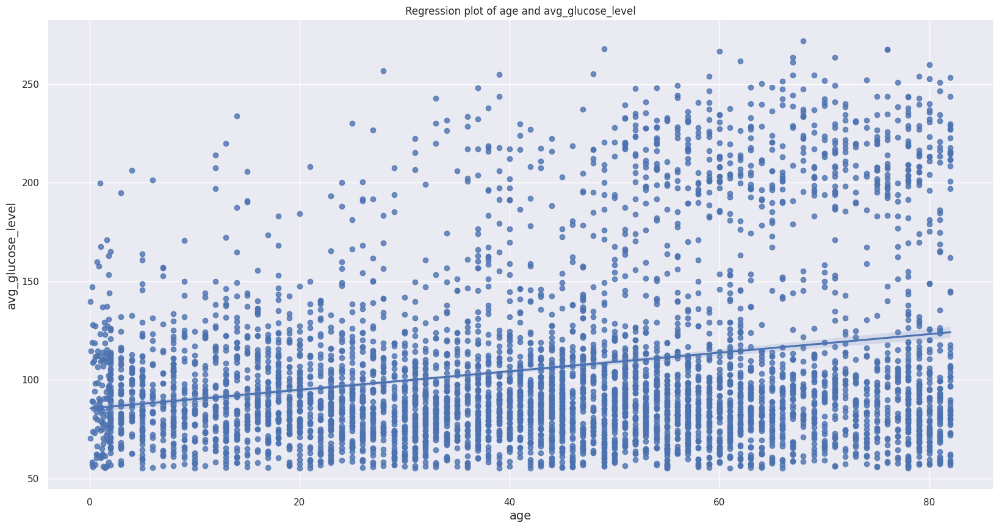

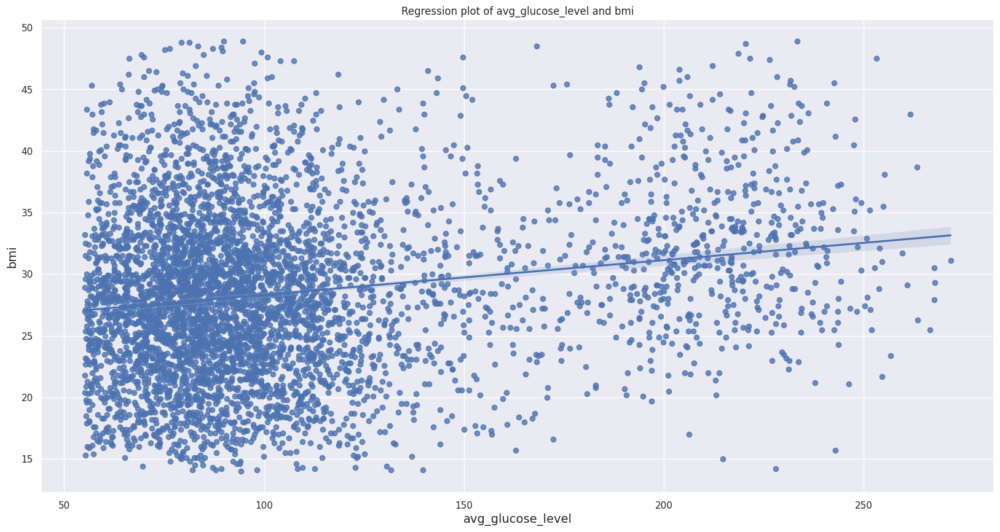

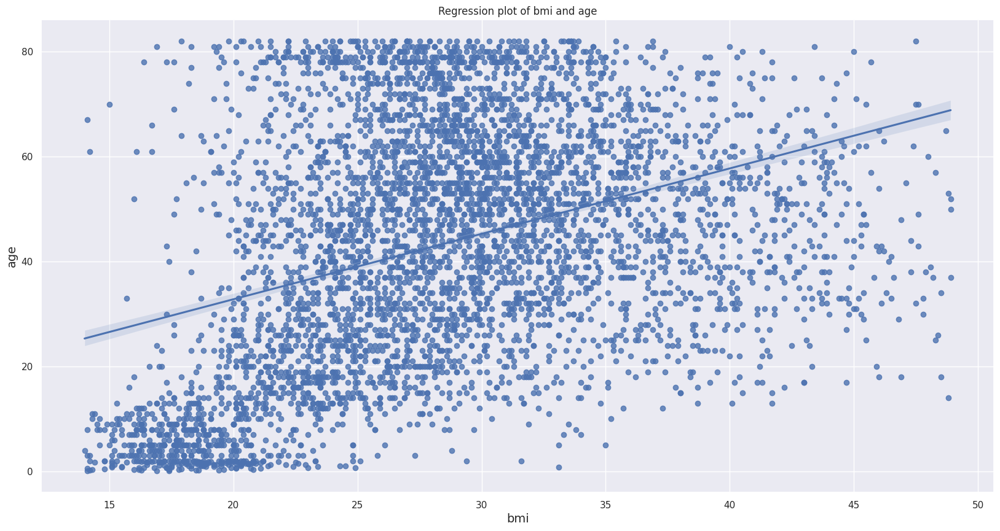

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


for i in range(len(df_reg[0])-1):
  sns.set_theme(color_codes=True)
  fig, ax = plt.subplots()
  fig.set_size_inches(20, 10)
  sns.regplot(x=df_reg[:,i], y=df_reg[:,i+1], data=df_reg, ax=ax)
  plt.xlabel(biva_df.columns[i],fontsize=14)
  plt.ylabel(biva_df.columns[i+1],fontsize=14)
  plt.title('Regression plot of '+biva_df.columns[i]+' and '+biva_df.columns[i+1])

### **Regression - Calculation**

In [ ]:
biva_df = pre_df[['age','avg_glucose_level','bmi']].copy()

In [ ]:
def regression_equation(x, y):
    x_mean = x.mean()
    y_mean = y.mean()
    x_squared = (x**2).sum()
    xy = (x*y).sum()
    std_dev = x.std()
    var_x = std_dev ** 2
    cov_xy = (xy - len(x)*x_mean*y_mean)/(len(x)-1)
    b_1 = cov_xy/var_x  # b_1 = m
    b_0 = y_mean - b_1*x_mean # b_0 = c
    print('Regression equation is: %.3f %.3f (x)' % (b_0, b_1))
    y_hat = b_0 + b_1*x
    return y_hat

In [ ]:
pred = []
pred.append(regression_equation(biva_df['age'], biva_df['avg_glucose_level']))
pred.append(regression_equation(biva_df['avg_glucose_level'], biva_df['bmi']))
pred.append(regression_equation(biva_df['bmi'], biva_df['age']))

Regression equation is: 85.497 0.471 (x)
Regression equation is: 25.524 0.028 (x)
Regression equation is: 7.877 1.247 (x)


In [ ]:
pred[2] = pred[2].astype(int)

### **Residuals**

In [ ]:
biva_df = pre_df[['age','avg_glucose_level','bmi']].copy()
biva_df['age_copy'] = biva_df['age']

In [ ]:
prediction = []
for i in range(len(pred)):
  list_rows = []
  new_df = pd.DataFrame()
  new_df[biva_df.columns[i]] = biva_df[biva_df.columns[i]].copy()
  new_df['Actual_'+biva_df.columns[i+1]] = biva_df[biva_df.columns[i+1]].copy()
  new_df['Predicted_'+biva_df.columns[i+1]] = pred[i].copy()
  new_df['Prediction_Error'] = abs(new_df['Actual_'+biva_df.columns[i+1]] - new_df['Predicted_'+biva_df.columns[i+1]]).copy()

  list_rows.append(new_df[biva_df.columns[i]])
  list_rows.append(new_df['Actual_'+biva_df.columns[i+1]])
  list_rows.append(new_df['Predicted_'+biva_df.columns[i+1]])
  list_rows.append(new_df['Prediction_Error'])
  prediction.append(list_rows)

In [ ]:
for i in range(len(prediction)):
  each_table = prediction[i].copy()
  each_table = pd.DataFrame(each_table)
  each_table = each_table.transpose()
  prediction[i] = each_table.copy()

In [ ]:
prediction[0].head()

,age,Actual_avg_glucose_level,Predicted_avg_glucose_level,Prediction_Error
0,67.0,228.69,117.047735,111.642265
1,80.0,105.92,123.169593,17.249593
2,49.0,171.23,108.571317,62.658683
3,79.0,174.12,122.698681,51.421319
4,81.0,186.21,123.640505,62.569495


In [ ]:
prediction[1].head()

,avg_glucose_level,Actual_bmi,Predicted_bmi,Prediction_Error
0,228.69,36.6,31.944005,4.655995
1,105.92,32.5,28.497512,4.002488
2,171.23,34.4,30.330944,4.069056
3,174.12,24.0,30.412074,6.412074
4,186.21,29.0,30.751474,1.751474


In [ ]:
prediction[2].head()

,bmi,Actual_age_copy,Predicted_age_copy,Prediction_Error
0,36.6,67.0,53.0,14.0
1,32.5,80.0,48.0,32.0
2,34.4,49.0,50.0,1.0
3,24.0,79.0,37.0,42.0
4,29.0,81.0,44.0,37.0


## **Multiple Regression**

In [ ]:
multi_reg_df = pre_df[['age','avg_glucose_level','bmi']].copy()

In [ ]:
#plot libaries
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode

configure_plotly_browser_state()

init_notebook_mode(connected=False)# to show plots in notebook

from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

SEED = 17 # specify seed for reproducable results
pd.set_option('display.max_columns', None) # prevents abbreviation (with '...') of columns in prints

colors = plotly.colors.DEFAULT_PLOTLY_COLORS

def create_scatter_trace(x, y, visible=False):
    return go.Scatter(x=multi_reg_df[x], y=multi_reg_df[y],
                    mode='markers',
                    name=y.title(),
                    marker = dict(
                        size=8,
                    ),
                    visible=visible)

def create_line_trace(x,y, visible=False):
    return go.Scatter(x=multi_reg_df[x], y=regression_equation(multi_reg_df[x],multi_reg_df[y]),
                    mode='lines',
                    name='Regression',
                    visible=visible)

features_not_for_reg = ['bmi']
features_for_reg = [x for x in multi_reg_df.columns if x not in features_not_for_reg]
active_idx = 0

traces_scatter = [(create_scatter_trace(col,'bmi') if i != active_idx else create_scatter_trace(col,'bmi', visible=True)) for i, col in enumerate(features_for_reg)]
traces_line = [(create_line_trace(col,'bmi') if i != active_idx else create_line_trace(col,'bmi', visible=True)) for i, col in enumerate(features_for_reg)]

data = traces_scatter + traces_line

n_features = len(features_for_reg)

steps = []
for i in range(n_features):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * len(data)],
        label = features_for_reg[i],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    step['args'][1][i + n_features] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = active_idx,
    currentvalue = dict(
        prefix = "Feature: ",
        xanchor= 'center',
    ),
    pad = {"t": 50},
    steps = steps,
)]

layout = dict(
    sliders=sliders,
    yaxis=dict(
        title='BMI',
        automargin=True,
    ),
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='regression_slider')

Regression equation is: 23.636 0.112 (x)
Regression equation is: 25.524 0.028 (x)


## **Correlation Coefficients**

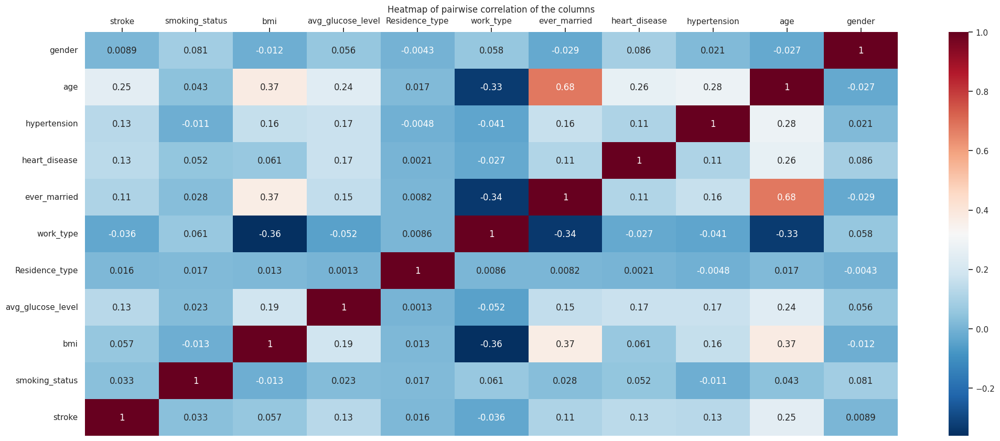

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(25, 10))

corr = pre_df.corr()

ax = sns.heatmap(corr, cmap = "RdBu_r", annot=True)

ax.invert_xaxis()

ax.xaxis.set_ticks_position('top')

plt.title("Heatmap of pairwise correlation of the columns")
plt.savefig("Attribute Correlation.jpg")
plt.show()

# **Model Implementation**

## **K Nearest Neighbours**

### **Import Dataset**

In [ ]:
import pandas as pd
pre_df = pd.read_csv("Copy_of_New_Brain_Stroke_Dataset.csv")

In [ ]:
knn_model_df = pre_df.copy()

### **Train Test split**

In [ ]:
X = knn_model_df.iloc[:,:-1].copy()
X.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status
0,1,67.0,0,1,1,0,1,228.69,36.6,3
1,1,80.0,0,1,1,0,0,105.92,32.5,1
2,0,49.0,0,0,1,0,1,171.23,34.4,2
3,0,79.0,1,0,1,2,0,174.12,24.0,1
4,1,81.0,0,0,1,0,1,186.21,29.0,3


In [ ]:
y = knn_model_df.iloc[:,-1].copy()
y.head()

0    1
1    1
2    1
3    1
4    1
Name: stroke, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [ ]:
X_train.shape

(3486, 10)

In [ ]:
y_train.shape

(3486,)

### **Apply K-Nearest Neighbor Model**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
model = KNeighborsClassifier(n_neighbors = 5)

In [ ]:
model.fit(X_train, y_train)
prediction = model.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score
result = accuracy_score(y_test, prediction)
result

0.934448160535117

In [ ]:
from sklearn.metrics import confusion_matrix
con_mat = confusion_matrix(y_test, prediction)
print(con_mat)

[[1397   12]
 [  86    0]]


In [ ]:
newMat = pd.DataFrame(data=con_mat, index = ['No Stroke','Stroke'], columns = ['No Stroke','Stroke'])
newMat.transpose()

,No Stroke,Stroke
No Stroke,1397,86
Stroke,12,0


In [ ]:
comparisonTable = pd.DataFrame(data = [y_test.values,prediction], index = ['Actual','Prediction'])
comparisonTable = comparisonTable.transpose()

## **Decision Tree**

### **Import Dataset and train test split**

In [ ]:
import pandas as pd
pre_df = pd.read_csv("Copy_of_New_Brain_Stroke_Dataset.csv")

In [ ]:
DT_model_df = pre_df.copy()

In [ ]:
X = DT_model_df.iloc[:,:-1].copy()
X.head()

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status
0,1,67.0,0,1,1,0,1,228.69,36.6,3
1,1,80.0,0,1,1,0,0,105.92,32.5,1
2,0,49.0,0,0,1,0,1,171.23,34.4,2
3,0,79.0,1,0,1,2,0,174.12,24.0,1
4,1,81.0,0,0,1,0,1,186.21,29.0,3


In [ ]:
y = DT_model_df.iloc[:,-1].copy()
y.head()

0    1
1    1
2    1
3    1
4    1
Name: stroke, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

### **Apply Decision Tree model with Gini Criterion and Information gain**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

clf_gini = DecisionTreeClassifier(criterion='gini',max_depth=3, random_state=42)  #c4.5 e criterion entropy hoito. tree er depth ekhane 3. amra onno depth dite partam.
clf_gini.fit(X_train, y_train)
y_pred_gini = clf_gini.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

score = accuracy_score(y_pred_gini, y_test)
print(score)

0.9478260869565217


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97      1417
           1       0.00      0.00      0.00        78

    accuracy                           0.95      1495
   macro avg       0.47      0.50      0.49      1495
weighted avg       0.90      0.95      0.92      1495



#### **Tree Plot**

[Text(0.5, 0.875, 'x[1] <= 67.5\ngini = 0.093\nsamples = 3486\nvalue = [3316, 170]'),
 Text(0.25, 0.625, 'x[1] <= 55.5\ngini = 0.046\nsamples = 2866\nvalue = [2799, 67]'),
 Text(0.125, 0.375, 'x[1] <= 37.5\ngini = 0.021\nsamples = 2305\nvalue = [2280, 25]'),
 Text(0.0625, 0.125, 'gini = 0.001\nsamples = 1377\nvalue = [1376, 1]'),
 Text(0.1875, 0.125, 'gini = 0.05\nsamples = 928\nvalue = [904, 24]'),
 Text(0.375, 0.375, 'x[7] <= 106.34\ngini = 0.139\nsamples = 561\nvalue = [519, 42]'),
 Text(0.3125, 0.125, 'gini = 0.082\nsamples = 351\nvalue = [336, 15]'),
 Text(0.4375, 0.125, 'gini = 0.224\nsamples = 210\nvalue = [183, 27]'),
 Text(0.75, 0.625, 'x[8] <= 29.35\ngini = 0.277\nsamples = 620\nvalue = [517, 103]'),
 Text(0.625, 0.375, 'x[8] <= 26.05\ngini = 0.327\nsamples = 345\nvalue = [274, 71]'),
 Text(0.5625, 0.125, 'gini = 0.254\nsamples = 154\nvalue = [131, 23]'),
 Text(0.6875, 0.125, 'gini = 0.376\nsamples = 191\nvalue = [143, 48]'),
 Text(0.875, 0.375, 'x[7] <= 231.375\ngini = 0.206

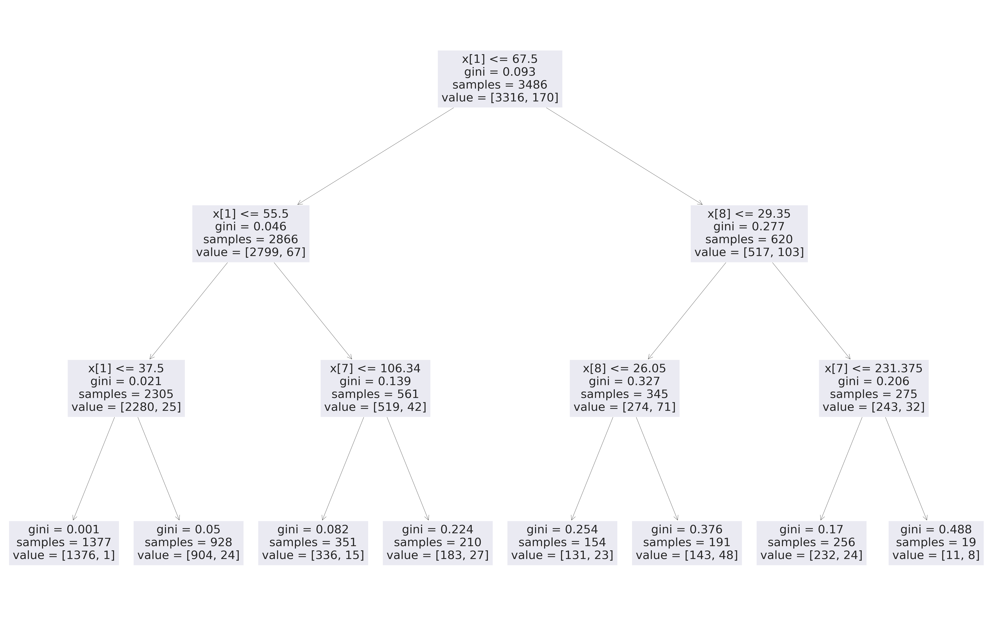

In [ ]:
#plotting decision tree on Train set.
import matplotlib.pyplot as plt
plt.figure(figsize=(80,50))

from sklearn import tree
tree.plot_tree(clf_gini.fit(X_train, y_train))

[Text(0.5, 0.875, 'x[1] <= 67.5\ngini = 0.099\nsamples = 1495\nvalue = [1417, 78]'),
 Text(0.25, 0.625, 'x[3] <= 0.5\ngini = 0.049\nsamples = 1263\nvalue = [1231, 32]'),
 Text(0.125, 0.375, 'x[8] <= 48.85\ngini = 0.037\nsamples = 1213\nvalue = [1190, 23]'),
 Text(0.0625, 0.125, 'gini = 0.036\nsamples = 1211\nvalue = [1189, 22]'),
 Text(0.1875, 0.125, 'gini = 0.5\nsamples = 2\nvalue = [1, 1]'),
 Text(0.375, 0.375, 'x[8] <= 32.75\ngini = 0.295\nsamples = 50\nvalue = [41, 9]'),
 Text(0.3125, 0.125, 'gini = 0.105\nsamples = 36\nvalue = [34, 2]'),
 Text(0.4375, 0.125, 'gini = 0.5\nsamples = 14\nvalue = [7, 7]'),
 Text(0.75, 0.625, 'x[7] <= 182.11\ngini = 0.318\nsamples = 232\nvalue = [186, 46]'),
 Text(0.625, 0.375, 'x[7] <= 56.145\ngini = 0.227\nsamples = 176\nvalue = [153, 23]'),
 Text(0.5625, 0.125, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(0.6875, 0.125, 'gini = 0.22\nsamples = 175\nvalue = [153, 22]'),
 Text(0.875, 0.375, 'x[5] <= 1.5\ngini = 0.484\nsamples = 56\nvalue = [33, 2

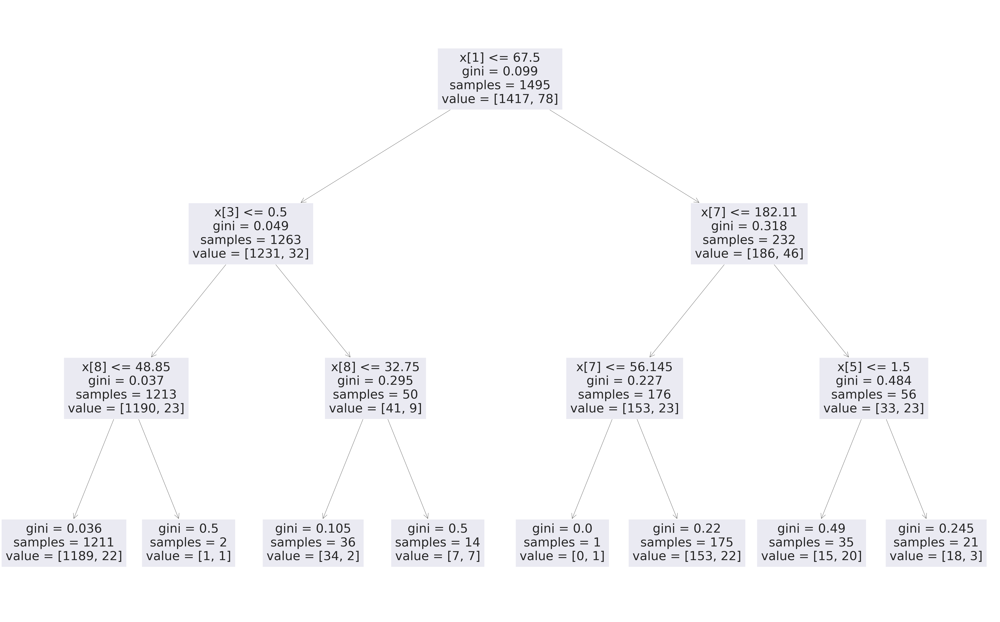

In [ ]:
#plotting decision tree on Test set.
import matplotlib.pyplot as plt
plt.figure(figsize=(80,50))

from sklearn import tree
tree.plot_tree(clf_gini.fit(X_test, y_test))

### **Apply Decision Tree model with Entropy Criterion and Information gain**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

clf_entropy = DecisionTreeClassifier(criterion='entropy',max_depth=3, random_state=42)
clf_entropy.fit(X_train, y_train)
y_pred_entropy = clf_entropy.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

score = accuracy_score(y_pred_entropy, y_test)
print(score)

0.9478260869565217


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_entropy))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97      1417
           1       0.00      0.00      0.00        78

    accuracy                           0.95      1495
   macro avg       0.47      0.50      0.49      1495
weighted avg       0.90      0.95      0.92      1495



#### **Tree Plot**

[Text(0.5, 0.875, 'x[1] <= 55.5\nentropy = 0.281\nsamples = 3486\nvalue = [3316, 170]'),
 Text(0.25, 0.625, 'x[1] <= 37.5\nentropy = 0.086\nsamples = 2305\nvalue = [2280, 25]'),
 Text(0.125, 0.375, 'x[1] <= 31.5\nentropy = 0.009\nsamples = 1377\nvalue = [1376, 1]'),
 Text(0.0625, 0.125, 'entropy = 0.0\nsamples = 1127\nvalue = [1127, 0]'),
 Text(0.1875, 0.125, 'entropy = 0.038\nsamples = 250\nvalue = [249, 1]'),
 Text(0.375, 0.375, 'x[8] <= 23.95\nentropy = 0.173\nsamples = 928\nvalue = [904, 24]'),
 Text(0.3125, 0.125, 'entropy = 0.0\nsamples = 123\nvalue = [123, 0]'),
 Text(0.4375, 0.125, 'entropy = 0.193\nsamples = 805\nvalue = [781, 24]'),
 Text(0.75, 0.625, 'x[1] <= 73.5\nentropy = 0.537\nsamples = 1181\nvalue = [1036, 145]'),
 Text(0.625, 0.375, 'x[7] <= 178.705\nentropy = 0.417\nsamples = 772\nvalue = [707, 65]'),
 Text(0.5625, 0.125, 'entropy = 0.339\nsamples = 589\nvalue = [552, 37]'),
 Text(0.6875, 0.125, 'entropy = 0.617\nsamples = 183\nvalue = [155, 28]'),
 Text(0.875, 0.375

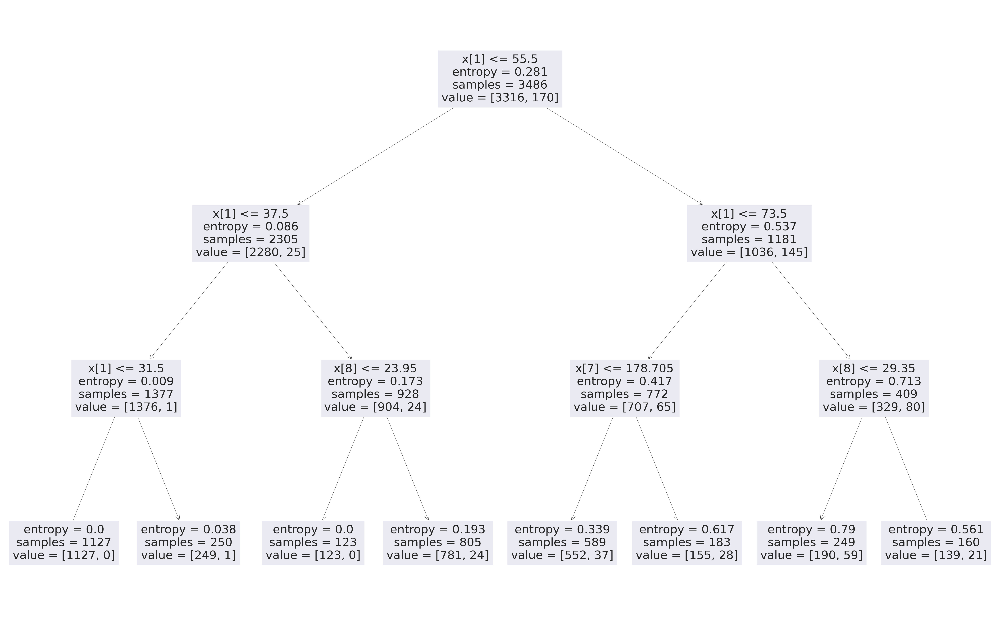

In [ ]:
#plotting decision tree.
import matplotlib.pyplot as plt
plt.figure(figsize=(80,50))

from sklearn import tree
tree.plot_tree(clf_entropy.fit(X_train, y_train))

[Text(0.4583333333333333, 0.875, 'x[1] <= 53.5\nentropy = 0.296\nsamples = 1495\nvalue = [1417, 78]'),
 Text(0.25, 0.625, 'x[0] <= 0.5\nentropy = 0.077\nsamples = 950\nvalue = [941, 9]'),
 Text(0.16666666666666666, 0.375, 'x[1] <= 44.5\nentropy = 0.114\nsamples = 588\nvalue = [579, 9]'),
 Text(0.08333333333333333, 0.125, 'entropy = 0.058\nsamples = 452\nvalue = [449, 3]'),
 Text(0.25, 0.125, 'entropy = 0.261\nsamples = 136\nvalue = [130, 6]'),
 Text(0.3333333333333333, 0.375, 'entropy = 0.0\nsamples = 362\nvalue = [362, 0]'),
 Text(0.6666666666666666, 0.625, 'x[7] <= 180.865\nentropy = 0.548\nsamples = 545\nvalue = [476, 69]'),
 Text(0.5, 0.375, 'x[1] <= 74.5\nentropy = 0.429\nsamples = 433\nvalue = [395, 38]'),
 Text(0.4166666666666667, 0.125, 'entropy = 0.329\nsamples = 331\nvalue = [311, 20]'),
 Text(0.5833333333333334, 0.125, 'entropy = 0.672\nsamples = 102\nvalue = [84, 18]'),
 Text(0.8333333333333334, 0.375, 'x[1] <= 67.5\nentropy = 0.851\nsamples = 112\nvalue = [81, 31]'),
 Text

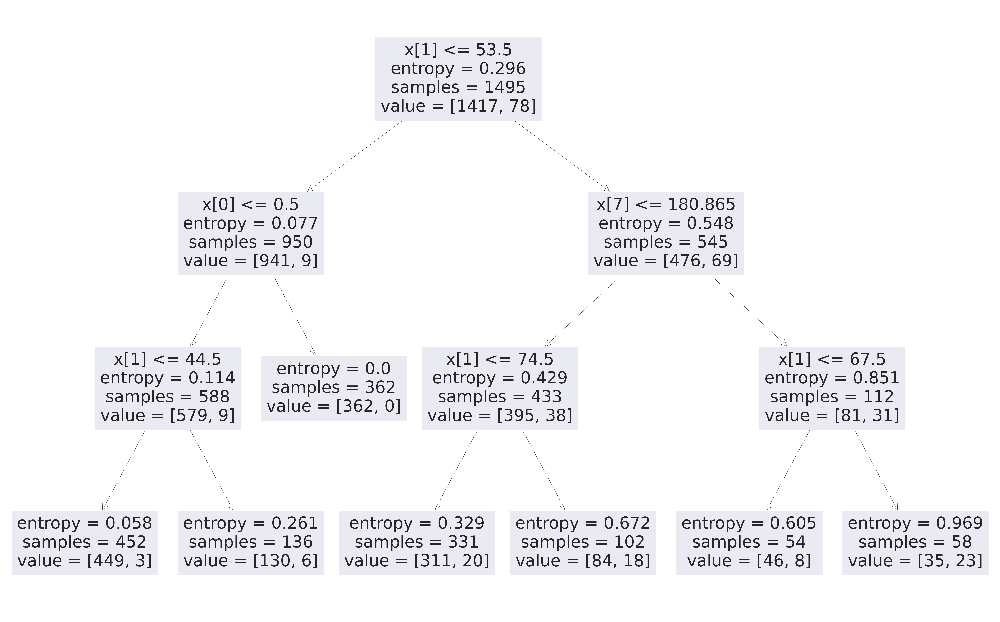

In [ ]:
#plotting decision tree.
import matplotlib.pyplot as plt
plt.figure(figsize=(80,50))

from sklearn import tree
tree.plot_tree(clf_entropy.fit(X_test, y_test))